# Using SQL to investigate dataset

##### by Sheng BI

#### Now I will use python to load the csv files in the Sqlite database. I will proceed in two steps.

**First step**: make connection and create data table

**Second step**: import the csv dataset into the created table.

In [1]:
import sqlite3
import pandas as pd
import numpy as np
import pprint
import datetime

%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

from ggplot import *

import folium
from folium import plugins 

In [2]:
db = sqlite3.connect(':memory:')

cur=db.cursor()

In [3]:
cur.executescript('''
CREATE TABLE nodes (
    id INTEGER PRIMARY KEY NOT NULL,
    lat REAL,
    lon REAL,
    user TEXT,
    uid INTEGER,
    version INTEGER,
    changeset INTEGER,
    timestamp TEXT
);

CREATE TABLE nodes_tags (
    id INTEGER,
    key TEXT,
    value TEXT,
    type TEXT,
    FOREIGN KEY (id) REFERENCES nodes(id)
);

CREATE TABLE ways (
    id INTEGER PRIMARY KEY NOT NULL,
    user TEXT,
    uid INTEGER,
    version TEXT,
    changeset INTEGER,
    timestamp TEXT
);

CREATE TABLE ways_tags (
    id INTEGER NOT NULL,
    key TEXT NOT NULL,
    value TEXT NOT NULL,
    type TEXT,
    FOREIGN KEY (id) REFERENCES ways(id)
);

CREATE TABLE ways_nodes (
    id INTEGER NOT NULL,
    node_id INTEGER NOT NULL,
    position INTEGER NOT NULL,
    FOREIGN KEY (id) REFERENCES ways(id),
    FOREIGN KEY (node_id) REFERENCES nodes(id)
);
''')

Now I Import csv files into SQL. [reference](https://bit.ly/2uJzQtQ)

Pandas dataframe will serve as an intermedium.

In [4]:
df_nodes_tags = pd.read_csv('nodes_tags.csv',encoding = 'utf-8')

In [5]:
my_schema = {
    'node': {
        'type': 'dict',
        'schema': {
            'id': {'required': True, 'type': 'integer', 'coerce': int},
            'lat': {'required': True, 'type': 'float', 'coerce': float},
            'lon': {'required': True, 'type': 'float', 'coerce': float},
            'user': {'required': True, 'type': 'string'},
            'uid': {'required': True, 'type': 'integer', 'coerce': int},
            'version': {'required': True, 'type': 'string'},
            'changeset': {'required': True, 'type': 'integer', 'coerce': int},
            'timestamp': {'required': True, 'type': 'string'}
        }
    },
    'node_tags': {
        'type': 'list',
        'schema': {
            'type': 'dict',
            'schema': {
                'id': {'required': True, 'type': 'integer', 'coerce': int},
                'key': {'required': True, 'type': 'string'},
                'value': {'required': True, 'type': 'string'},
                'type': {'required': True, 'type': 'string'}
            }
        }
    },
    'way': {
        'type': 'dict',
        'schema': {
            'id': {'required': True, 'type': 'integer', 'coerce': int},
            'user': {'required': True, 'type': 'string'},
            'uid': {'required': True, 'type': 'integer', 'coerce': int},
            'version': {'required': True, 'type': 'string'},
            'changeset': {'required': True, 'type': 'integer', 'coerce': int},
            'timestamp': {'required': True, 'type': 'string'}
        }
    },
    'way_nodes': {
        'type': 'list',
        'schema': {
            'type': 'dict',
            'schema': {
                'id': {'required': True, 'type': 'integer', 'coerce': int},
                'node_id': {'required': True, 'type': 'integer', 'coerce': int},
                'position': {'required': True, 'type': 'integer', 'coerce': int}
            }
        }
    },
    'way_tags': {
        'type': 'list',
        'schema': {
            'type': 'dict',
            'schema': {
                'id': {'required': True, 'type': 'integer', 'coerce': int},
                'key': {'required': True, 'type': 'string'},
                'value': {'required': True, 'type': 'string'},
                'type': {'required': True, 'type': 'string'}
            }
        }
    }
}

In [6]:
df_nodes_tags.to_sql(name = 'nodes_tags', con = db,\
                     if_exists='replace', index=False, schema = my_schema)

In [7]:
# table : nodes

df_nodes = pd.read_csv('nodes.csv',encoding = 'utf-8')
df_nodes.to_sql(name = 'nodes', con = db,\
                    if_exists='replace', index=False, schema = my_schema)

In [8]:
# table : ways

df_ways = pd.read_csv('ways.csv',encoding = 'utf-8')
df_ways.to_sql(name = 'ways', con = db,\
                    if_exists='replace', index=False, schema = my_schema)

In [9]:
# table: ways_nodes

df_ways_nodes = pd.read_csv('ways_nodes.csv',encoding = 'utf-8')
df_ways_nodes.to_sql(name = 'ways_nodes', con = db,\
                    if_exists='replace', index=False, schema = my_schema)

In [10]:
# table: ways_tags

df_ways_tags = pd.read_csv('ways_tags.csv',encoding = 'utf-8')
df_ways_tags.to_sql(name = 'ways_tags', con = db,\
                    if_exists='replace', index=False, schema = my_schema)

#### I form a heatmap to visualize the geographic coordinates.

In [11]:
geographic_coord_list = []
for index, row in df_nodes.iterrows():
    geographic_coord_list.append([row['lat'],row['lon']])

# reference: https://bit.ly/2HrYq7O

In [12]:
geographic_center = [34.0928, -118.3287] # geographic coordinates: 34.0928 N, 118.3287 W

hollywood_map = \
folium.Map(location = geographic_center, \
           tiles = 'Stamen Toner', zoom_start = 12, control_scale=True)

## Since the number of nodes is too large to display, 
## I will only select 1/6 of the nodes for the heatmap.
hollywood_map.\
add_child(plugins.HeatMap(geographic_coord_list[0:40000],
                     min_opacity=1,
                     radius=10, blur=30,
                     max_zoom=1 )); 

hollywood_map

# reference: https://bit.ly/2qCnyhP

### Part 1. Map data analysis

#### Sort tag keys by count (top 100 displayed)

In [13]:
## notice that the value is a representative from a given group with identical keys.

cur.execute('''
select A.key, A.value, count(*) as num
from (select * from nodes_tags
      union all
      select * from ways_tags) A
group by A.key
having num >= 50
order by num desc
;
''')

pprint.pprint(cur.fetchall())

[(u'building', u'commercial', 20264),
 (u'ele', u'56', 19830),
 (u'height', u'30.5', 19778),
 (u'bld_id', u'443050853126', 19774),
 (u'ain', u'4341033023', 19771),
 (u'start_date', u'2017', 19052),
 (u'units', u'1', 17578),
 (u'highway', u'footway', 2208),
 (u'name', u'Beverly Connection Shopping Center', 2157),
 (u'source', u'mapillary', 973),
 (u'lanes', u'3', 945),
 (u'city', u'West Hollywood', 872),
 (u'street', u'North Formosa Avenue', 860),
 (u'housenumber', u'1140', 856),
 (u'postcode', u'90046, Los Angeles', 803),
 (u'leisure', u'park', 786),
 (u'state', u'CA', 757),
 (u'cfcc', u'A41', 676),
 (u'county', u'Los Angeles, CA', 676),
 (u'name_base', u'Larrabee', 670),
 (u'name_type', u'St', 670),
 (u'surface', u'asphalt', 548),
 (u'amenity', u'parking', 541),
 (u'backward', u'1', 460),
 (u'forward', u'2', 406),
 (u'phone', u'+1-310-859-7447', 388),
 (u'name_direction_prefix', u'N', 383),
 (u'website', u'http://www.trusthairsalon.com', 376),
 (u'shop', u'hairdresser', 327),
 (u'open

I will investigate certain entries in detail. Since the union of the tables `nodes_tags` and `ways_tags` are used quite often, I will first create an outer union of these two tables.

In [14]:
cur.executescript('''
CREATE TABLE tags_nodes_ways (
    id INTEGER,
    key TEXT,
    value TEXT,
    type TEXT,
    FOREIGN KEY (id) REFERENCES nodes(id)
);

INSERT INTO tags_nodes_ways 
    SELECT * FROM nodes_tags
    UNION ALL
    SELECT * FROM ways_tags;

''')

# cur.executescript('''
# drop table tags_nodes_ways
# ;
# ''')

In [15]:
cur.execute('''
select count(*)
from tags_nodes_ways
''')
pprint.pprint(cur.fetchall())


[(158932,)]


#### Sort amenities by count

In [16]:
cur.execute('''
select A.value, count(*) as num
from tags_nodes_ways as A 
where A.key == 'amenity'
group by A.value
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'restaurant', 118),
 (u'parking', 97),
 (u'waste_basket', 47),
 (u'cafe', 31),
 (u'place_of_worship', 24),
 (u'fast_food', 22),
 (u'school', 21),
 (u'fuel', 15),
 (u'bank', 14),
 (u'bar', 14),
 (u'studio', 14),
 (u'atm', 10),
 (u'nightclub', 10),
 (u'theatre', 10),
 (u'post_box', 9),
 (u'pharmacy', 8),
 (u'hospital', 7),
 (u'post_office', 7),
 (u'ice_cream', 5),
 (u'vending_machine', 5),
 (u'whirlpool', 5),
 (u'car_rental', 4),
 (u'dentist', 4),
 (u'fountain', 4),
 (u'library', 4),
 (u'veterinary', 4),
 (u'arts_centre', 3),
 (u'bicycle_rental', 3),
 (u'cinema', 3),
 (u'fire_station', 3),
 (u'bench', 2),
 (u'doctors', 2),
 (u'police', 2),
 (u'shelter', 2),
 (u'brothel', 1),
 (u'car_wash', 1),
 (u'dojo', 1),
 (u'money_transfer', 1),
 (u'pub', 1),
 (u'public_building', 1),
 (u'telephone', 1),
 (u'townhall', 1)]


#### Sort religions by count

In [17]:
cur.execute('''
select tags_nodes_ways.value, count(*) as num
from tags_nodes_ways
join (select distinct(id) 
      from tags_nodes_ways
      where value == 'place_of_worship') A
  on A.id == tags_nodes_ways.id
where tags_nodes_ways.key == 'religion'
group by tags_nodes_ways.value
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'christian', 14), (u'jewish', 8), (u'buddhist', 1)]


Sort Restaurants by count.

Observations:
1. Italian and Japanese food are especially popular.
2. Fast food is popular, such as Sushi, Burger, Pizza, Sandwich.

In [18]:
cur.execute('''
select tags_nodes_ways.value, count(*) as num
from tags_nodes_ways
join (select distinct(id) 
      from tags_nodes_ways
      where value == 'restaurant' or value == 'fast_food') A
  on A.id == tags_nodes_ways.id
where tags_nodes_ways.key == 'cuisine'
group by tags_nodes_ways.value
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'burger', 10),
 (u'italian', 8),
 (u'japanese', 8),
 (u'mexican', 8),
 (u'pizza', 7),
 (u'american', 5),
 (u'sandwich', 4),
 (u'sushi', 4),
 (u'chinese', 3),
 (u'steak_house', 3),
 (u'thai', 3),
 (u'indian', 2),
 (u'pancake', 2),
 (u'seafood', 2),
 (u'Upscale_Comfort_Food', 1),
 (u'american;fine_dining', 1),
 (u'asian', 1),
 (u'barbecue', 1),
 (u'brazilian', 1),
 (u'burger;hotdog', 1),
 (u'burger;mexican', 1),
 (u'chicken', 1),
 (u'corsican', 1),
 (u'greek', 1),
 (u'grill', 1),
 (u'hawaiian', 1),
 (u'hotdog;burger', 1),
 (u'kebab', 1),
 (u'mediterranean', 1),
 (u'mexican;vegetarian', 1),
 (u'peruvian', 1),
 (u'pizza,_burger,_american', 1),
 (u'ramen;japanese', 1),
 (u'russian', 1),
 (u'salad', 1),
 (u'spanish;sandwich', 1),
 (u'tacos', 1),
 (u'vietnamese', 1)]


#### Sort Banks by count: Chase and Wells Fargo both have 4 branches.

In [20]:
cur.execute('''
select tags_nodes_ways.id, tags_nodes_ways.key, tags_nodes_ways.value, 
       count(*) as num
from tags_nodes_ways
join (select distinct(id) 
      from tags_nodes_ways
      where value == 'bank') A
  on A.id == tags_nodes_ways.id
where tags_nodes_ways.key == 'name'
group by tags_nodes_ways.value
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(440269302, u'name', u'Chase', 4),
 (5247316878L, u'name', u'Wells Fargo', 4),
 (391157722, u'name', u'Bank of America', 2),
 (425405625, u'name', u'Citibank', 1),
 (391157716, u'name', u'U.S. Bank', 1),
 (429386287, u'name', u'Union Bank', 1),
 (5206110790L, u'name', u'Western Union', 1)]


#### Sort postal codes by count

In [21]:
cur.execute('''
select tags_nodes_ways.value, count(*) as num
from tags_nodes_ways
where tags_nodes_ways.key == 'postcode'
group by tags_nodes_ways.value
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'90069, West Hollywood', 601),
 (u'90046, Los Angeles', 124),
 (u'90210, Beverly Hills', 46),
 (u'90036, Los Angeles', 11),
 (u'90048, Los Angeles', 10),
 (u'90038, Los Angeles', 5),
 (u'90028, Los Angeles', 4),
 (u'90004, Los Angeles', 1),
 (u'90027, Los Angeles', 1)]


#### Sort leisure by count: 

- people love doing sports. In particular, swimming seems to be the most popular activity, which is followed by baseball

In [23]:
cur.execute('''
select A.value, count(*) as num
from tags_nodes_ways as A 
where A.key == 'leisure'
group by A.value
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'swimming_pool', 701),
 (u'pitch', 49),
 (u'park', 15),
 (u'fitness_centre', 9),
 (u'sports_centre', 6),
 (u'playground', 4),
 (u'tanning_salon', 1),
 (u'track', 1)]


#### Sort sport by count

In [24]:
cur.execute('''
select A.value, count(*) as num
from tags_nodes_ways as A 
where A.key == 'sport'
group by A.value
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'tennis', 37),
 (u'basketball', 7),
 (u'baseball', 4),
 (u'yoga', 3),
 (u'dance', 2),
 (u'pilates', 2),
 (u'american_football', 1),
 (u'golf', 1),
 (u'karate', 1),
 (u'running', 1),
 (u'swimming', 1)]


Sort shop by count:

- clothes,beauty,hairdresser,jewelry and shoes have high rankins.
  - I would conclude that fashion consumption plays an essential role in this area. 

In [25]:
cur.execute('''
select A.value, count(*) as num
from tags_nodes_ways as A 
where A.key == 'shop'
group by A.value
having num >= 3
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'clothes', 73),
 (u'beauty', 43),
 (u'hairdresser', 24),
 (u'jewelry', 9),
 (u'shoes', 9),
 (u'supermarket', 9),
 (u'convenience', 7),
 (u'department_store', 7),
 (u'tattoo', 7),
 (u'alcohol', 6),
 (u'laundry', 6),
 (u'mall', 6),
 (u'massage', 6),
 (u'tobacco', 6),
 (u'gift', 5),
 (u'nutrition_supplements', 5),
 (u'optician', 5),
 (u'pet', 5),
 (u'antiques', 4),
 (u'books', 4),
 (u'boutique', 4),
 (u'electronics', 4),
 (u'furniture', 4),
 (u'yes', 4),
 (u'art', 3),
 (u'car', 3),
 (u'car_repair', 3),
 (u'sports', 3),
 (u'watches', 3)]


#### Sort tourism by count

It seems that a lot of people here for vacation:
- the number of attractions is low
- the number of hotels is high

In [26]:
cur.execute('''
select A.value, count(*) as num
from tags_nodes_ways as A 
where A.key == 'tourism'
group by A.value
having num >= 3
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'hotel', 42),
 (u'motel', 9),
 (u'attraction', 6),
 (u'guest_house', 4),
 (u'artwork', 3),
 (u'yes', 3)]


##### Addtional Ideas:

From the results, I notice that the same data entry often appears in different names. I could give several examples.

Example 1: `source` of data.
- As we could see, the search engine `Bing` appears in the following forms: `u'TIGER, Bing`, `u'Bing`, `u'Bing; TIGER 2012`, `u'bing`, `u'Tiger2011; Bing`.

In [27]:
cur.execute('''
select tags_nodes_ways.value, count(*) as num
from tags_nodes_ways
where tags_nodes_ways.key == 'source'
group by tags_nodes_ways.value
order by num desc
;
''')
pprint.pprint(cur.fetchall())

[(u'mapillary', 575),
 (u'TIGER, Bing', 296),
 (u'survey', 36),
 (u'Bing', 30),
 (u'USGS Geonames', 16),
 (u'Bing; TIGER 2012', 5),
 (u'GPS; survey; Yahoo', 3),
 (u'TIGER/Line\xae 2008 Place Shapefiles (http://www.census.gov/geo/www/tiger/)',
  3),
 (u'bing', 2),
 (u'satellite', 2),
 (u'Jason Sodenkamp - Proprietor', 1),
 (u'Los Angeles Fire Department', 1),
 (u'Tiger2011;Bing', 1),
 (u'Yahoo', 1),
 (u'solar', 1)]


In order to obtain the correct number elements with source `Bing`, we could use the following code:

In [28]:
cur.execute('''
select tags_nodes_ways.value, count(*) as num
from tags_nodes_ways
where tags_nodes_ways.key == 'source' and tags_nodes_ways.value like '%bing%'
order by num desc
;
''')
pprint.pprint(cur.fetchall())

# reference: https://bit.ly/2JPKPp9

[(u'Bing', 334)]


Example 2: `name` of coffee shops.
- Starbucks appears as u'Starbucks Coffee' and u'Starbucks'. 

In [29]:
cur.execute('''
select * 
from (select tags_nodes_ways.id, tags_nodes_ways.key, tags_nodes_ways.value, 
       count(*) as num
      from tags_nodes_ways
      join (select distinct(id) 
            from tags_nodes_ways
            where value == 'cafe') A
      on A.id == tags_nodes_ways.id
      where tags_nodes_ways.key == 'name'
      group by tags_nodes_ways.value
      order by num desc) B
where B.value like '%Starbucks%'
;
''')
pprint.pprint(cur.fetchall())

[(429313746, u'name', u'Starbucks Coffee', 6),
 (3833300156L, u'name', u'Starbucks', 1)]


Example 3: `name` of shops. 
- We could notice that `7-eleven` appears as u'7-Eleven', u'7 Eleven', and u'7-eleven'.

In [30]:
cur.execute('''
select * 
from (
      select tags_nodes_ways.id, tags_nodes_ways.key, tags_nodes_ways.value, 
             count(*) as num
      from tags_nodes_ways
      join (select distinct(id) 
            from tags_nodes_ways
            where key == 'shop') A
        on A.id == tags_nodes_ways.id
      where tags_nodes_ways.key == 'name'
      group by tags_nodes_ways.value
      order by num desc
      ) B
WHERE instr(B.value, '7') > 0
;
''')
pprint.pprint(cur.fetchall())

[(3384647299L, u'name', u'7-Eleven', 3),
 (3825249428L, u'name', u'7 Eleven', 1),
 (4901842621L, u'name', u'7-eleven', 1)]


### Part 2. User activity analysis
---

#### Number of nodes:

In [31]:
cur.execute('''
select count(*)
from nodes;
''')
pprint.pprint(cur.fetchall())

[(256998,)]


#### Number of ways:

In [32]:
cur.execute('''
select count(*)
from ways;
''')
pprint.pprint(cur.fetchall())

[(23891,)]


#### Number of nodes and ways:

In [33]:
cur.execute('''
select count(distinct(A.id))
from (select id from nodes 
      union all 
      select id from ways) A
;
''')
pprint.pprint(cur.fetchall())

[(280889,)]


#### Number of unique users:

In [34]:
cur.execute('''
select count(distinct(A.user))
from (select user from nodes 
      union all 
      select user from ways) A
;
''')
pprint.pprint(cur.fetchall())

[(251,)]


#### Top 10 contributing users:

In [35]:
cur.execute('''
select A.user, count(*) as num
from (select user from nodes 
      union all 
      select user from ways) A
group by A.user
order by num desc
limit 10
;
''')
pprint.pprint(cur.fetchall())


[(u'schleuss_imports', 130738),
 (u'dannykath_labuildings', 35912),
 (u'manings_labuildings', 23468),
 (u'RichRico_labuildings', 12544),
 (u'piligab_labuildings', 11952),
 (u'Luis36995_labuildings', 10488),
 (u'karitotp', 9836),
 (u'yurasi_import', 5556),
 (u'bdiscoe_imports', 4349),
 (u'markbegbie', 4007)]


#### Number of users appearing less than 3 times

In [36]:
cur.execute('''
select count(*)
from (select A.user, count(*) as num
      from (select user from nodes
            union all
            select user from ways) A
      group by A.user
      having num <= 3) B
;
''')
pprint.pprint(cur.fetchall())

[(96,)]


We observe that contributions from users are highly skewed: 88.59% of the entries are contributed by the following users.

|username | contributions count | percentage
|---|---|---|
|u'schleuss_imports' | 130738| 46.54%|
|u'dannykath_labuildings' | 35912|12.79%|
|u'manings_labuildings'| 23468|8.35%|
|u'RichRico_labuildings'| 12544|4.47%|
|u'piligab_labuildings'| 11952|4.26%|
|u'Luis36995_labuildings'| 10488|3.73%|
|u'karitotp'| 9836|3.50%|
|u'yurasi_import'| 5556|1.98%|
|u'bdiscoe_imports'| 4349|1.55%|
|u'markbegbie'| 4007|1.43%|
|*TOTAL*|248850|88.59%|

Most of the users names end with `_imports` or `_labuildings` (see [Los Angeles County building import](https://github.com/osmlab/labuildings)). This suggests that the data were actually imported rather than entered manually. We now verify this point.

If the data were imported, we would expect a large amount of data inflow within short amount of time. We now try to visualize the data by date.

In [37]:
## I concatenate two tables,
## which is equivalent to the 'union all' operation in sqlite:

df_nodes_ways_ct = pd.concat([df_ways.iloc[:,[0,1,5]],\
                              df_nodes.iloc[:,[0,3,7]]],join='outer')

## I define a function to extract information from a timestamp.

def date_sep(date_str, datetime_format, method = 'n'):
        
    if method == 'n':
        return datetime.datetime.strptime(date_str, datetime_format)
    elif method == 'year':
        return datetime.datetime.strptime(date_str, datetime_format).year
    elif method == 'month':
        return datetime.datetime.strptime(date_str, datetime_format).month
    elif method == 'day':
        return datetime.datetime.strptime(date_str, datetime_format).day
    elif method == 'weekday':
        return datetime.datetime.strptime(date_str, datetime_format).weekday()
    elif method == 'hour':
        return datetime.datetime.strptime(date_str.replace('Z',''), \
                                          datetime_format).hour

df_nodes_ways_ct['ymd'] = \
df_nodes_ways_ct['timestamp'].str.split('T').str.get(0)\
.apply(date_sep, args = ('%Y-%m-%d',))

df_nodes_ways_ct['year'] = \
df_nodes_ways_ct['timestamp'].str.split('T').str.get(0)\
.apply(date_sep, args = ('%Y-%m-%d',), method = 'year')

df_nodes_ways_ct['month'] = \
df_nodes_ways_ct['timestamp'].str.split('T').str.get(0)\
.apply(date_sep, args = ('%Y-%m-%d',), method = 'month')

df_nodes_ways_ct['day'] = \
df_nodes_ways_ct['timestamp'].str.split('T').str.get(0)\
.apply(date_sep, args = ('%Y-%m-%d',), method = 'day')

df_nodes_ways_ct['weekday'] = \
df_nodes_ways_ct['timestamp'].str.split('T').str.get(0)\
.apply(date_sep, args = ('%Y-%m-%d',), method = 'weekday')

df_nodes_ways_ct['hour'] = \
df_nodes_ways_ct['timestamp'].str.split('T').str.get(1)\
.apply(date_sep, args = ('%H:%M:%S',), method = 'hour')

In [38]:
## I now use iteractive graphs to display the results.
## The following packages are needed.

import plotly.plotly as py
import cufflinks as cf

In [39]:
## interactive graphs.

cf.go_offline()
df_nodes_ways_ct.ymd.dt.date.iplot(kind='histogram',\
                              filename='cufflinks/basic-histogram')

We notice unusually high data contributions in the following periods: Jun and July 2016. I now look at the data contributions by day for each month respectively.

[<matplotlib.text.Text at 0x226ce908>, <matplotlib.text.Text at 0x223bc908>]

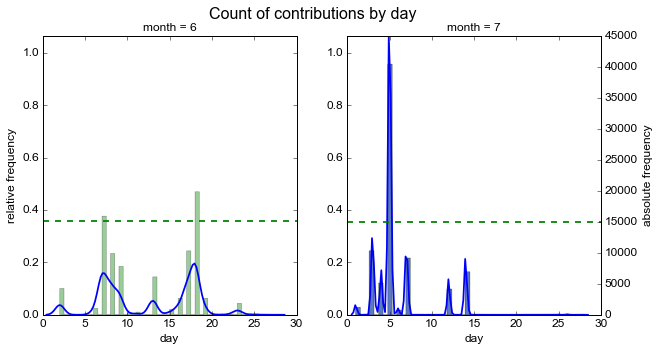

In [40]:
fig = plt.figure(figsize = (10,5))

plt.suptitle('Count of contributions by day', fontsize=16)

ax1 = fig.add_subplot(1,2,1)

ax2 = fig.add_subplot(1,2,2, sharey = ax1)
ax21 = ax2.twinx()

sns.set()
sns.set_style('dark')

sns.distplot(df_nodes_ways_ct[(df_nodes_ways_ct['year'] == 2016) & \
                              (df_nodes_ways_ct['month']==6)]['day'],
            ax = ax1, 
            hist_kws={"histtype": "stepfilled", "linewidth": 0.5,
                                    "alpha": 0.4, "color": "g"})
ax1.axhline( y = 0.36, color = 'g', linestyle = '--')
ax1.set(ylabel='relative frequency', title = 'month = 6')

sns.distplot(df_nodes_ways_ct[(df_nodes_ways_ct['year'] == 2016) & \
                              (df_nodes_ways_ct['month']==7)]['day'],
            ax = ax2, 
            hist_kws={"histtype": "stepfilled", "linewidth": 0.5,
                                    "alpha": 0.4, "color": "g"})
 
sns.distplot(df_nodes_ways_ct[(df_nodes_ways_ct['year'] == 2016) & \
                              (df_nodes_ways_ct['month'].isin([7]))]['day'],
            ax = ax21, kde = False)

ax21.axhline( y = 15000 , color = 'g', linestyle = '--')
ax21.set(ylabel='absolute frequency', title = 'month = 7')

## reference: seaborn using the matplotlib object-oriented interface
## https://bit.ly/2H8pslg

## reference: sharing axes.
## https://bit.ly/2qKCf2e

## reference: Annotate matplotlib chart
## https://python-graph-gallery.com/193-annotate-matplotlib-chart/

There are three days by which the user contribution is greater than 15000 (above the green dotted line). 

I wonder for each of these three days, how many contributors there were.

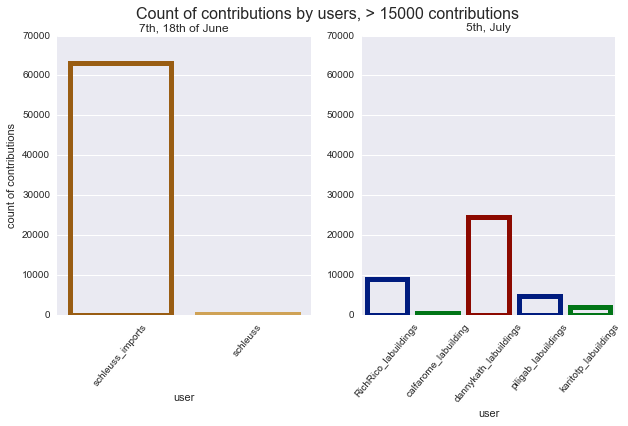

In [42]:
fig = plt.figure(figsize = (10,5))

plt.suptitle('Count of contributions by users, > 15000 contributions', fontsize=16)

ax1 = fig.add_subplot(1,2,1)

ax2 = fig.add_subplot(1,2,2,sharey = ax1)

sns.set()
sns.set_context("notebook")

sns.countplot(x = df_nodes_ways_ct[(df_nodes_ways_ct['year'] == 2016) & \
                              (df_nodes_ways_ct['month']==6) & \
                             (df_nodes_ways_ct['day'].isin([7,18]))]['user'],
             ax = ax1,\
              facecolor = (0,0,0,0),\
             linewidth=5,\
              edgecolor=sns.color_palette("BrBG", 7))

ax1.set(ylabel='count of contributions', title = '7th, 18th of June')
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=50)

sns.countplot(x = df_nodes_ways_ct[(df_nodes_ways_ct['year'] == 2016) & \
                              (df_nodes_ways_ct['month']==7) & \
                             (df_nodes_ways_ct['day']==5)]['user'],
             ax = ax2,\
              facecolor = (0,0,0,0),\
             linewidth=5,\
              edgecolor=sns.color_palette("dark", 3))

ax2.set(ylabel=' ', title = '5th, July')
ax2.set_xticklabels(ax2.get_xticklabels(), rotation=50)

From the left-hand graph, we notice that `Schleuss` is the only contributor for 7th, 18th of June: it seems that the user `Schleuss` imports data under the name `Schleuss_imports` and around 63090 entries were imported under the name `Schleuss_imports`; however, only 170 entries were under the name Schleuss. I think this is a clear sign of automatic versus manual work. 

At last, I am intereted to see users are most active at which day in the week, and at which hours during a day.

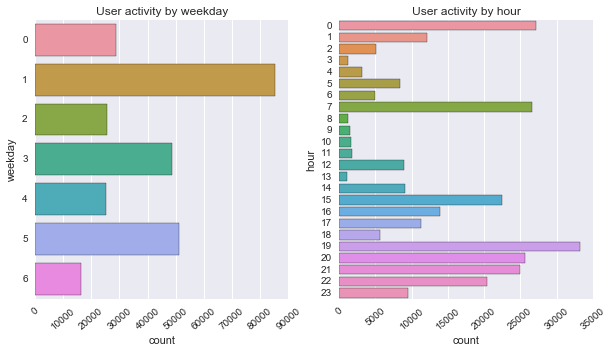

In [43]:
fig = plt.figure(figsize = (10,5))

# plt.suptitle('Count of contributions by users', fontsize=16)

ax1 = fig.add_subplot(1,2,1)

ax2 = fig.add_subplot(1,2,2)

sns.set()
sns.set_context("notebook")

sns.countplot(y = df_nodes_ways_ct['weekday'], ax = ax1)

ax1.set(ylabel='weekday', title = 'User activity by weekday')
ax1.set_xticklabels(ax1.get_xticks().astype(int), rotation=40)

sns.countplot(y = df_nodes_ways_ct['hour'],
             ax = ax2)

ax2.set(title = 'User activity by hour')
ax2.set_xticklabels(ax2.get_xticks().astype(int), rotation=40)

##### Left-hand Graph: 

`0`: Monday. `1`: Tuesday. `2`: Wednesday. `3`: Thursday. `4`: Friday. `5`: Saturday. `6`: Sunday.

Most of the data were entered on Tuesday, which is followed by Saturday and Thursday. However, we have to take this result with caution given that most of the data is imported.

##### Rght-hand Graph:

OpenStreetMap (OSM) is a collaborative project and maintained by volunteers. Hence, it makes sense to observe that most of the contributions are not made at working time, i.e., from 8:00 to 18:00.